<center>
<h1><b>STYLEGAN2-ADA NOTEBOOK : Unsupervised analysis of latent space</b></h1>
</center>



# Table of Contents

- Section 1: Method from the article
  - 1.1 Getting started with Stylegan
  - 1.2 Implementation of GANspace
  - 1.3 Results
  - Kernel PCA instead of PCA
    
- Section 2: Comparison between PCA and KPCA space
  
- Section 3: Section 3: Restructuring the latent space with an autoencoder
  - Training the Autoencoder and creating a dsiplacement in this space using PCA analysis
  - Exploring this new space 
  - Projecting vectors in this restructured space and applying the method of GANSpace in it
 


In [1]:
import generate_nb
import matplotlib.pyplot as plt
import torch
import numpy as np
import dnnlib
import legacy
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import importlib

import projector_nb
importlib.reload(projector_nb)
import numpy as np
import torch
import os
import imageio
from tqdm import tqdm
import matplotlib.pyplot as plt

from joblib import dump, load
from sklearn.decomposition import KernelPCA
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
print(torch.cuda.is_available())

device = torch.device('cuda:1')

print(device)

True
cuda:1



# Section 1: Method from the article

---

## 1.1 Getting started with Stylegan


In [ ]:

image = generate_nb.generate_images(
    network_pkl='https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl',
    seeds=[0],  # single seed for one image
    truncation_psi=0.7,
    noise_mode='const',
    outdir='out',
    class_idx=None,
    projected_w=None,
    show=True,
    device = device
)

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl"...
Generating image for seed 0 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.


/home/infres/billy-22/stylegan/torch_utils/ops/conv2d_gradfix.py:43: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at /home/conda/feedstock_root/build_artifacts/libtorch_1716579264291/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return torch.nn.functional.conv_transpose2d(input=input, weight=weight, bias=bias, stride=stride, padding=padding, output_padding=output_padding, groups=groups, dilation=dilation)


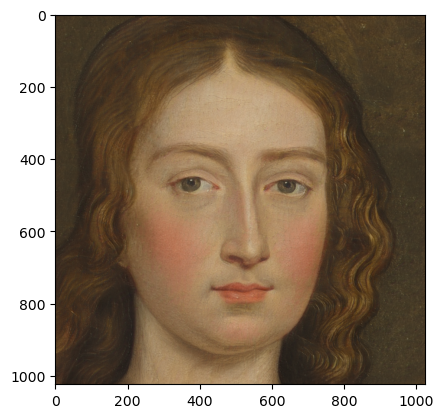

In [ ]:
plt.imshow(image)

**Loading the network**

In [3]:
network = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
name = 'out/seed0085.png'
outdir = 'ignored_outputs'
#projector_nb.run_projection(network_pkl=network,target_fname=name, outdir = outdir, save_video=True, seed=1,num_steps=100,device=device)

## 1.2 Implementation of GANspace

x is the vector that has zeros everywhere excepet where the user want to modify

**PCA**: Shapes of the attributes of this class

components_ndarray of shape (n_components, n_features)

explained_variance_ndarray of shape (n_components,)

The movement is computed as follow in the article: V @ x

V: (n_components, n_features) | x: (n_features, 1)

Shape of V @ x is (n_components, 1)

In [4]:
with dnnlib.util.open_url(network) as fp:
        G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device)

In [5]:
def generate_samples(G, num_samples):
    z_samples = np.random.RandomState().randn(num_samples, 512).astype(np.float32) 
    
    w_samples = G.mapping(torch.from_numpy(z_samples).to(device), None)  # [N, L, C]
    w_samples = w_samples.cpu().numpy()
    w_samples = w_samples[:,0,:]

    return w_samples

def get_pca(samples,ncomp):
    
    scaler = StandardScaler()
    samples_scaled = scaler.fit_transform(samples)  

    pca = PCA(n_components=ncomp)
    pca.fit(samples_scaled)

    explained_variance = pca.explained_variance_ratio_
    cumulative_explained_variance = np.cumsum(explained_variance)

    # Plot explained variance
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
    plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid',
         label='Cumulative Explained Variance')

    plt.xlabel('Principal Component Index')
    plt.ylabel('Explained Variance Ratio')
    plt.title('PCA Explained Variance')
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

    return pca , scaler

In [6]:
w_samples = generate_samples(G, 10000)

Setting up PyTorch plugin "bias_act_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.


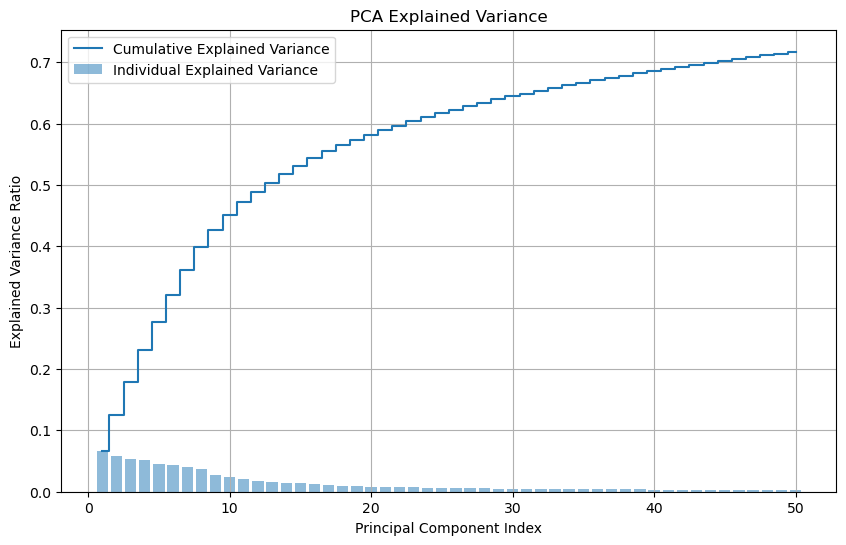

In [7]:
pca , scaler = get_pca(w_samples,ncomp=50)

**Visualisation of data with TSNE**

The TSNE is a tool to visual high dimensional data, we will proejct the data in the first 50 components   to reduce first the dimension.


In [ ]:
w_scaled = scaler.transform(w_samples)
w_projected = pca.transform()

In [8]:
def move_according_to_component(G, device, pca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    explained_variance = pca.explained_variance_
    V = pca.components_.T
   
    # Generate a random z vector
    #z_sample = np.random.RandomState().randn(1, 512).astype(np.float32)  # select a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    w_sample = scaler.transform(w_sample)

    img_list = []
    w_list = []

    # Initialize x
    x = np.zeros((V.shape[1], 1))
    X =  np.tile(x, (1, num_steps))

    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(explained_variance[v])
        start_value = -2* sigma
        end_value = 2* sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
    
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
      
        w_new = w_sample.T + movement
        w_new = w_new.T
        w_new = scaler.inverse_transform(w_new)
        W = np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
        W[:,layers,:] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

In [ ]:
#### Visualization of the X matrix used to move along different directions

explained_variance = pca.explained_variance_
V = pca.components_.T
x = np.zeros((V.shape[1], 1))
X =  np.tile(x, (1, 10))
directions = [0,3]
for v in directions:
    sigma = explained_variance[v]
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 10 + 2)[1:-1]
    X[v] = arrays_between

for i in range(X.shape[0]):
    x_tmp = X[i,:]
    print(x_tmp)

[-54.77004797 -42.5989262  -30.42780443 -18.25668266  -6.08556089
   6.08556089  18.25668266  30.42780443  42.5989262   54.77004797]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-43.26433182 -33.65003586 -24.0357399  -14.42144394  -4.80714798
   4.80714798  14.42144394  24.0357399   33.65003586  43.26433182]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

In [9]:
def plot_results(img_list, X_list, num_images_plot=5):
   
    # Determine the indices of images to plot
    indices = np.linspace(0, len(img_list) - 1, num=num_images_plot, dtype=int)
    
    # Plot the images
    n_cols = 5
    n_rows = (num_images_plot + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()

    for i, idx in enumerate(indices):
        axes[i].imshow(img_list[idx])
        axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

This code allows to move on different directions at the same time, according to the variance in the corresponding dimension.
All coordinates of x moves at the same ratio from $-2 \sigma$ to $2 \sigma$. 

## 1.3 Results

### **One direction and all layers**

**v0 direction: Gender**

The gender evolves from a woman to a man, glasses appear, hair change. In the middle he has no beard and then slowly gets one.

Setting up PyTorch plugin "upfirdn2d_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.


/home/infres/billy-22/stylegan/torch_utils/ops/conv2d_gradfix.py:43: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at /home/conda/feedstock_root/build_artifacts/libtorch_1716579264291/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return torch.nn.functional.conv_transpose2d(input=input, weight=weight, bias=bias, stride=stride, padding=padding, output_padding=output_padding, groups=groups, dilation=dilation)


Editing video ...
Saving optimization progress video "output_directory_pca/gender_all.mp4"
Video saved


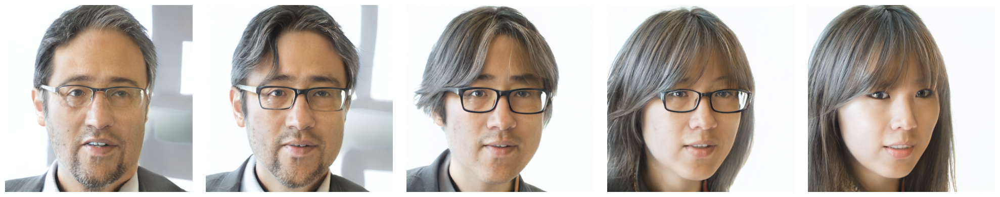

In [10]:
#Gender 
directions = [0]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_all',random_seed=2)


plot_results(img_list_gender, X_list_gender)

**v1 direction: Gender and rotate**

Editing video ...
Saving optimization progress video "output_directory_pca/gender_rotate_all.mp4"
Video saved


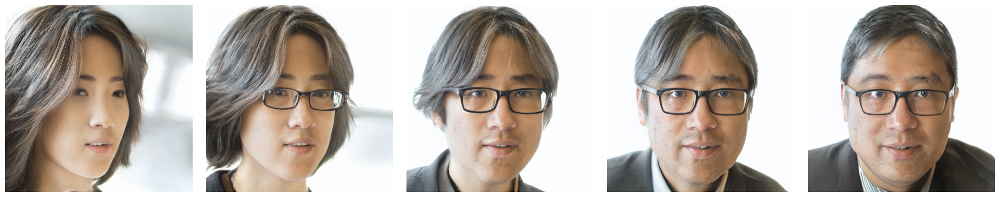

In [11]:
#Gender and rotate
directions = [1]
layers =list(range(0, 18))
img_list_gender_rotate ,X_list_gender_rotate = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_rotate_all',random_seed=2)

plot_results(img_list_gender_rotate, X_list_gender_rotate)

#### v2 direction: Gender, rotate, age, background

Age here is more visible as we explore the v2 directions

Editing video ...
Saving optimization progress video "output_directory_pca/gender_rotate_age_all.mp4"
Video saved


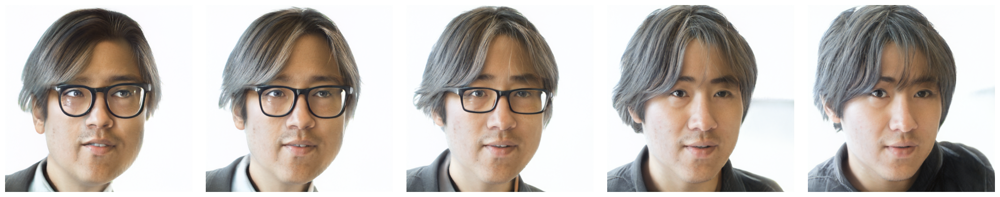

In [12]:
#Gender, rotate, age, background
directions = [2]
layers =list(range(0, 18))
img_list_gender_rotate_age ,X_list_gender_rotate_age = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_rotate_age_all',random_seed=2)

plot_results(img_list_gender_rotate_age, X_list_gender_rotate_age)

### **One direction and layer wise**


**Gender**

Only hair changes and the rotation too

Editing video ...
Saving optimization progress video "output_directory_pca/gender_lw.mp4"
Video saved


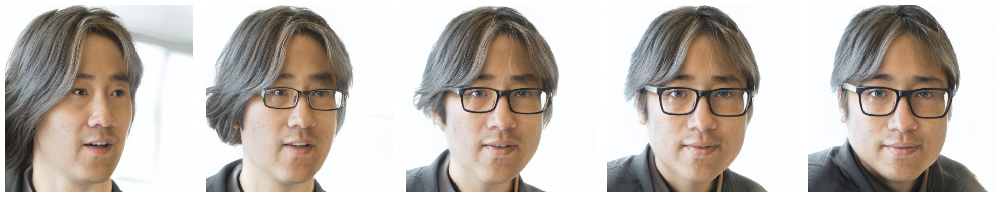

In [13]:
# Gender

directions = [1]
layers = [0,1,2]
img_list_gender_lw, X_list_gender_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_lw',random_seed=2)

plot_results(img_list_gender_lw, X_list_gender_lw)

**Age and hairstyle**


Editing video ...
Saving optimization progress video "output_directory_pca/age_hairstyle_lw.mp4"
Video saved


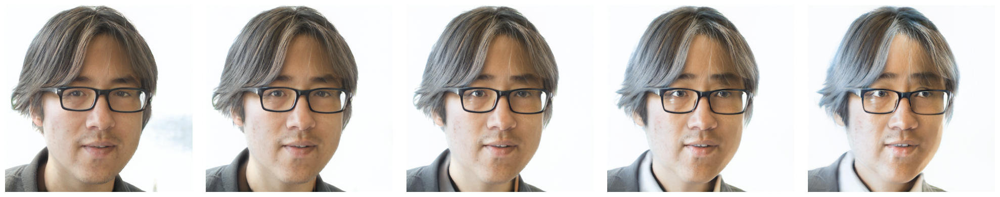

In [14]:
# Age and hairstyle

directions = [4]
layers = list(range(5, 18))
img_list_age_lw,X_list_age_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='age_hairstyle_lw',random_seed=2)


plot_results(img_list_age_lw, X_list_age_lw)

**Hair color**

We observe an evolution from black to black and white/grey

Editing video ...
Saving optimization progress video "output_directory_pca/hair_color_lw.mp4"
Video saved


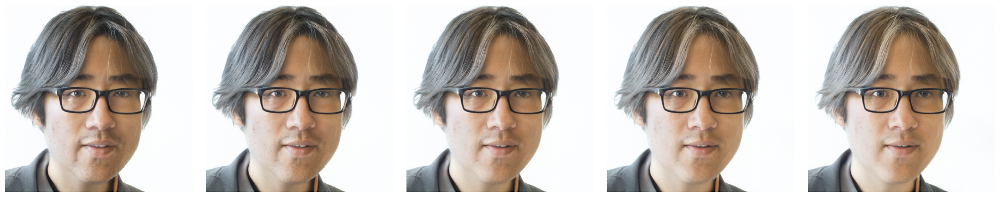

In [15]:
# Hair color

directions = [10]
layers = [7,8]
img_list_hair_color_lw, X_list_hair_color_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_color_lw',random_seed=2)

plot_results(img_list_hair_color_lw, X_list_hair_color_lw)

**Hair above forehead**

Not much results there

Editing video ...
Saving optimization progress video "output_directory_pca/hair_forehead_lw.mp4"
Video saved


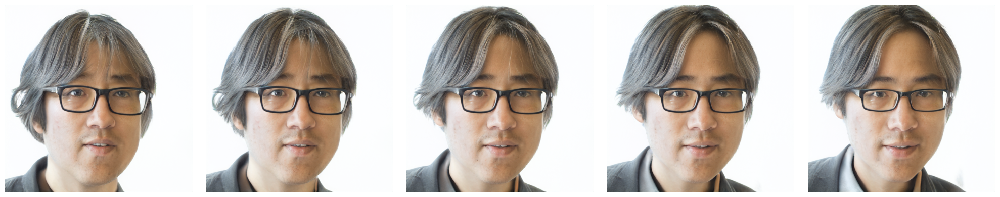

In [16]:
# Hair forehead

directions = [11]
layers = list(range(0, 5))
img_list_hair_forehead_lw,X_list_hair_forehead_lw  = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_forehead_lw',random_seed=2)

plot_results(img_list_hair_forehead_lw, X_list_hair_forehead_lw)

**Wrinkles**

Here we observe that beard appear on the man face

Editing video ...
Saving optimization progress video "output_directory_pca/wrinkles_lw.mp4"
Video saved


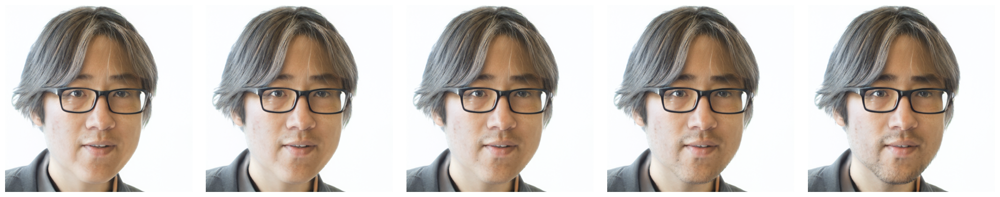

In [17]:
# Wrinkles

directions = [20]
layers = [6]
img_list_wrinkles_lw,X_list_wrinkles_lw  = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='wrinkles_lw',random_seed=2)

plot_results(img_list_wrinkles_lw, X_list_wrinkles_lw)

**Expression**

The person is slowly smiling, the rest is not changing that much.

Editing video ...
Saving optimization progress video "output_directory_pca/expression_lw.mp4"
Video saved


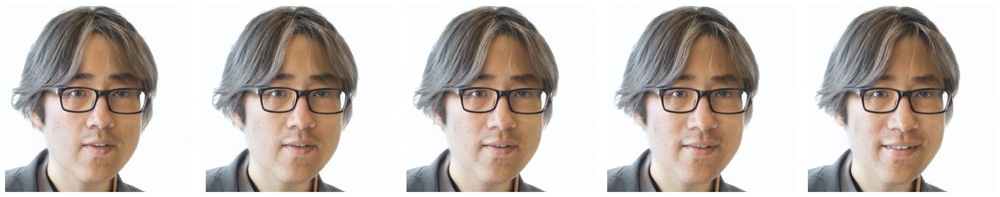

In [18]:
# Expression

directions = [23]
layers = [3,4,5]
img_list_expression_lw ,X_list_expression_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='expression_lw',random_seed=2)

plot_results(img_list_expression_lw, X_list_expression_lw)

Editing video ...
Saving optimization progress video "output_directory_pca/expression_lw.mp4"
Video saved


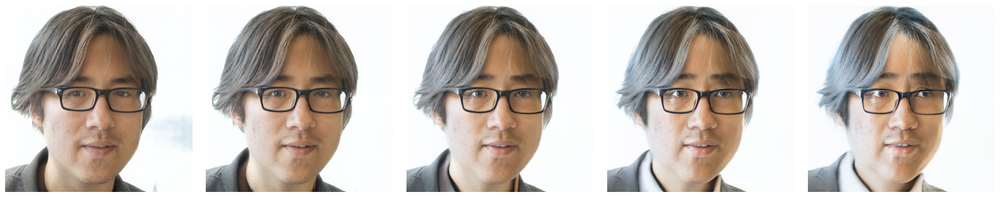

In [19]:
# Exposure

directions = [4]
layers = list(range(5, 18))
img_list_exposure_lw ,X_list_exposure_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='expression_lw',random_seed=2)

plot_results(img_list_exposure_lw, X_list_exposure_lw)

# Attempts to disantanglement

---

## Kernel PCA instead of PCA

In [20]:
w_samples_kpca = generate_samples(G,5000)

KPCA = KernelPCA(n_components=100,  kernel='rbf', coef0=1,fit_inverse_transform=True)
scaler = StandardScaler()
w_samples_kpca = scaler.fit_transform(w_samples_kpca) 

In [21]:
#KPCA.fit(w_samples_kpca)

In [22]:
#dump(KPCA, 'kpca_model_rbf_100compo_10000sampels.joblib')

In [23]:
KPCA_kernel = load('kpca_model_rbf_100compo_10000sampels.joblib')



**KPCA**

eigenvectors_ndarray of shape (n_samples, n_components)

eigenvalues_ndarray of shape (n_components,)

V_kpca : n_samples, n_components


In [24]:
z_sample = np.random.randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :]  
w_sample = scaler.transform(w_sample)

X_transformed = KPCA_kernel.transform(w_sample) 
X_inv = KPCA_kernel.inverse_transform(X_transformed) # Project original data to kernel principal components  # (if fit_inverse_transform=True) Map back to original space

In [25]:
w_transformed = KPCA_kernel.transform(w_sample)

# Initialize x in the KPCA-transformed space
x = np.zeros((w_transformed.shape[1], 1))
X = np.tile(x, (1, 100))
print(X.shape)

sigma = 20
start_value = -sigma
end_value =  sigma
arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
X[1] = arrays_between

print(X.shape)

(100, 100)
(100, 100)


In [26]:
x_tmp = X[:,1]
x_tmp.reshape(1, -1)
movement = KPCA_kernel.inverse_transform(x_tmp.reshape(1, -1))
print( movement.shape)

(1, 512)


In [27]:
def move_according_to_component_kpca(G, device, kpca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    eigenvalues = kpca.eigenvalues_
    eigenvectors = kpca.eigenvectors_
   
    # Generate a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    w_sample = scaler.transform(w_sample)

    img_list = []
    w_list = []

    # Initialize x
    w_transformed = kpca.transform(w_sample)

    # Initialize x in the KPCA-transformed space
    x = np.zeros((w_transformed.shape[1], 1))
    X = np.tile(x, (1, num_steps))


    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(eigenvalues[v])
        print(sigma)
        start_value = -sigma
        end_value =  sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:, i]
        
        movement = KPCA_kernel.inverse_transform(x_tmp.reshape(1, -1))
        
        # move according to direction in KPCA space
        w_new = w_sample + movement
        w_new = scaler.inverse_transform(w_new)
        
        W = np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
        W[:, layers, :] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

**testing KPCA with all layers in the first directions**

---

We observe that the direction works like in pca, the gender changes, however the hair seems to be less modified when moving according to this direction. The clothe change colors

4.3453536
Editing video ...
Saving optimization progress video "output_directory_pca/kpca_dir0.mp4"
Video saved


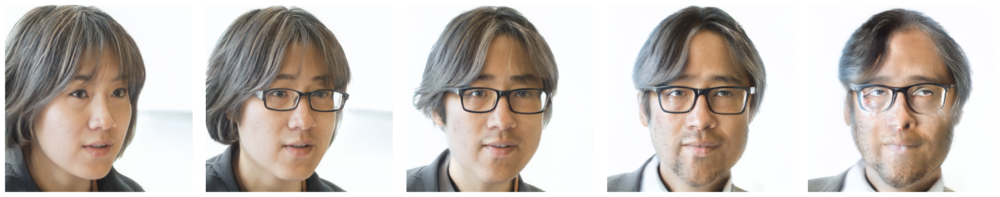

In [28]:
# Test with KPCA

directions = [0]
layers =list(range(0, 18))
img_list_kpca , X_list_kpca = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='kpca_dir0',random_seed=2)

plot_results(img_list_kpca, X_list_kpca)

Here thegender changes like in the v1 of pca

4.23369


Editing video ...
Saving optimization progress video "output_directory_pca/test_kpca.mp4"
Video saved


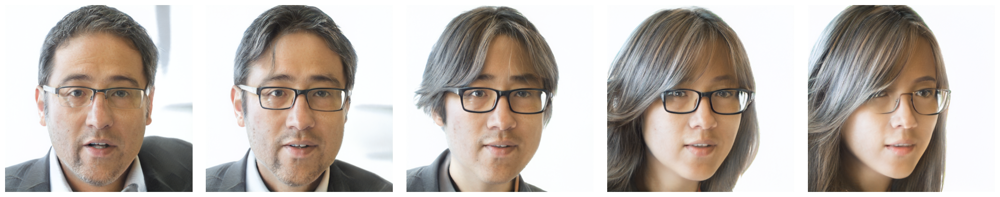

In [29]:
directions = [1]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test_kpca',random_seed=2)

plot_results(img_list, X_list)

3.9368377


Editing video ...
Saving optimization progress video "output_directory_pca/test_kpca.mp4"
Video saved


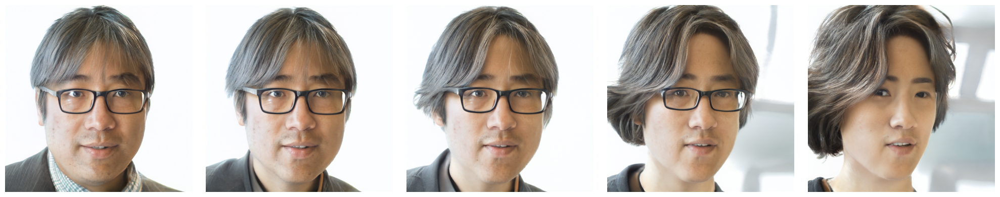

In [30]:
directions = [2]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test_kpca',random_seed=2)

plot_results(img_list, X_list)

4.23369
Editing video ...
Saving optimization progress video "output_directory_pca/gender_lw_kpca.mp4"
Video saved


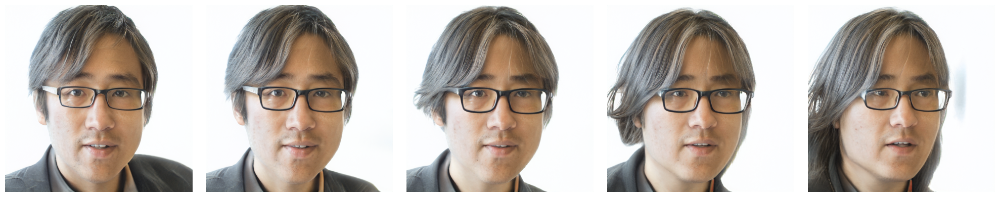

In [38]:
# Gender

directions = [1]
layers = [0,1,2]
img_list_gender_lw, X_list_gender_lw = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_lw_kpca',random_seed=2)

plot_results(img_list_gender_lw, X_list_gender_lw)

3.7284968
Editing video ...
Saving optimization progress video "output_directory_pca/age_hairstyle_lw_kpca.mp4"
Video saved


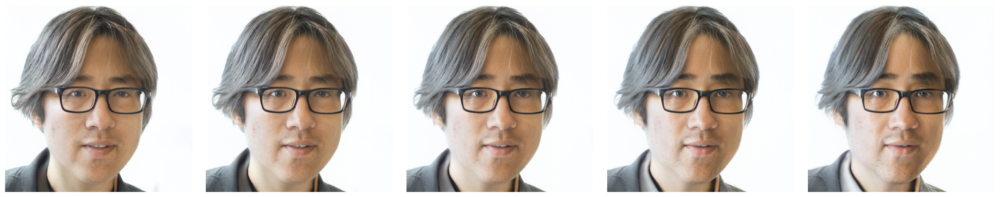

In [39]:
# Age and hairstyle

directions = [4]
layers = list(range(5, 18))
img_list_age_lw,X_list_age_lw = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='age_hairstyle_lw_kpca',random_seed=2)


plot_results(img_list_age_lw, X_list_age_lw)

2.874748
Editing video ...
Saving optimization progress video "output_directory_pca/hair_color_lw_kpca.mp4"
Video saved


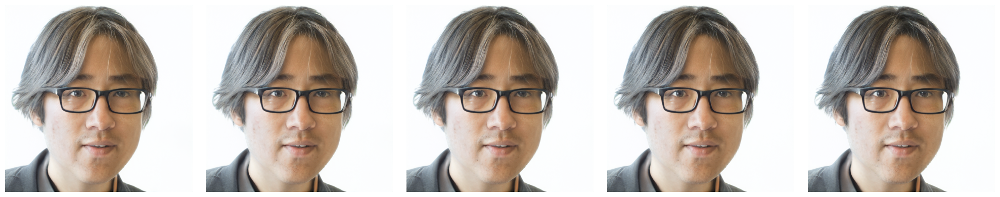

In [40]:
# Hair color

directions = [10]
layers = [7,8]
img_list_hair_color_lw, X_list_hair_color_lw = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_color_lw_kpca',random_seed=2)

plot_results(img_list_hair_color_lw, X_list_hair_color_lw)

1.8339951
Editing video ...
Saving optimization progress video "output_directory_pca/wrinkles_lw_kpca.mp4"
Video saved


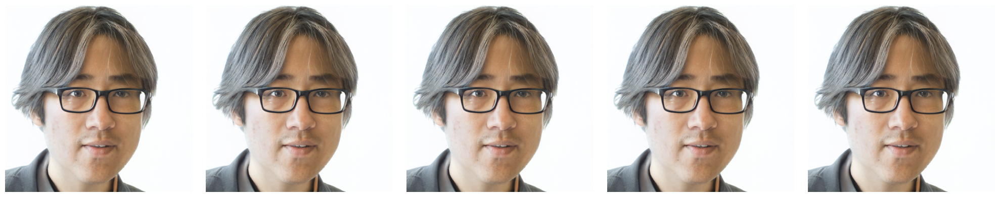

In [41]:
# Wrinkles

directions = [20]
layers = [6]
img_list_wrinkles_lw,X_list_wrinkles_lw  = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='wrinkles_lw_kpca',random_seed=2)

plot_results(img_list_wrinkles_lw, X_list_wrinkles_lw)

Putting the results of PCA knowledg in the first layer permitted to reduce by a factor two the loss, but still it does not seem that the autoencoder learns things there.

The results from the vector obtained throught the VAE is still working fine, we can now explore the latent space of this autoencoder with pca. First we need to get a better autoencoder.


<center>
 <h2> Section 2: Differences between PCA and KPCA <h2>
<center>
 
---

# Importing libraries 

In [1]:
import generate_nb
import matplotlib.pyplot as plt
import torch
import numpy as np
import dnnlib
import legacy
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import importlib
import projector_nb
importlib.reload(projector_nb)
import numpy as np
import torch
import os
import imageio
import matplotlib.pyplot as plt
from joblib import dump, load
from sklearn.decomposition import KernelPCA
from sklearn.metrics.pairwise import cosine_similarity

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/threadpoolctl.py:1010: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)


In [2]:
print(torch.cuda.is_available())
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print(device)

False
cpu


# Getting started with the generating function



In [4]:
image = generate_nb.generate_images(
    network_pkl='https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl',
    seeds=[245],  # single seed for one image
    truncation_psi=1,
    noise_mode='const',
    outdir='out',
    class_idx=None,
    projected_w=None,
    show=True
)

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl"...


/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/setuptools/distutils_patch.py:25: UserWarning: Distutils was imported before Setuptools. This usage is discouraged and may exhibit undesirable behaviors or errors. Please use Setuptools' objects directly or at least import Setuptools first.
  warnings.warn(


Generating image for seed 245 (0/1) ...


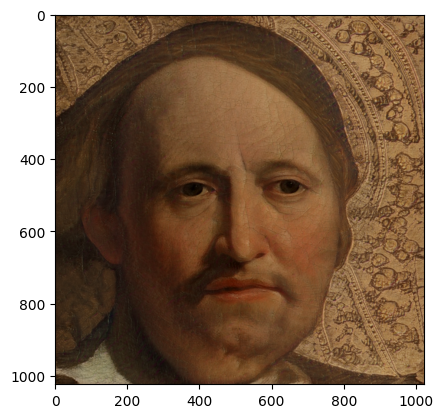

In [5]:
plt.imshow(image)

# Loading the network

In [3]:
network = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
name = 'out/seed0085.png'
outdir = 'ignored_outputs'

In [4]:
with dnnlib.util.open_url(network) as fp:
        G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/setuptools/distutils_patch.py:25: UserWarning: Distutils was imported before Setuptools. This usage is discouraged and may exhibit undesirable behaviors or errors. Please use Setuptools' objects directly or at least import Setuptools first.
  warnings.warn(


# Generating the samples

La première étape serait de générer des échantillons afin de réaliser notre PCA et notre KPCA sur des échantillons de différentes tailles. 

In [5]:
def generate_samples(G, num_samples):
    z_samples = np.random.RandomState().randn(num_samples, 512).astype(np.float32) 
    
    w_samples = G.mapping(torch.from_numpy(z_samples).to(device), None)  # [N, L, C]
    w_samples = w_samples.cpu().numpy()
    w_samples = w_samples[:,0,:]

    return w_samples

def get_pca(samples):
    
    scaler = StandardScaler()
    w_samples = scaler.fit_transform(samples)  

    pca = PCA(n_components=100)
    pca.fit(w_samples)

    explained_variance = pca.explained_variance_ratio_
    cumulative_explained_variance = np.cumsum(explained_variance)

    # Plot explained variance
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
    plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid',
         label='Cumulative Explained Variance')

    plt.xlabel('Principal Component Index')
    plt.ylabel('Explained Variance Ratio')
    plt.title('PCA Explained Variance')
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

    return pca , scaler

In [28]:
w_samples = generate_samples(G, 10000)

# Trying two PCAs 


Ici, nous faisons deux PCA différents. En effet, réaliser deux PCA nous fait remarquer une part d'aléatoire au niveau des échantillons choisis. Il ne serait donc pas surprenant qu'il y ait une légère différence entres les composantes trouvées par le pca1 et celles trouvées avec le pca2 même avec les mêmes échantillons. 

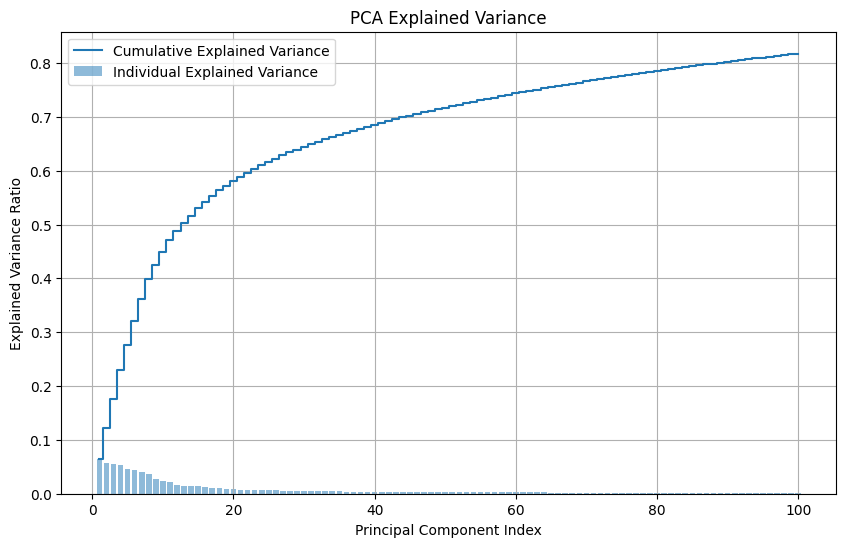

In [29]:
pca , scaler = get_pca(w_samples)

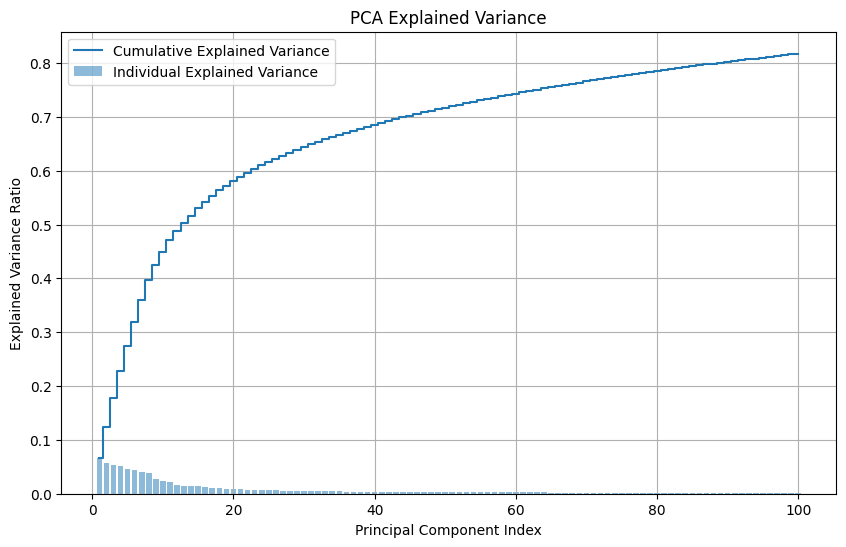

In [16]:
pca2 , scaler2 = get_pca(w_samples)



---

## Trying Kernel PCA instead of PCA 


On cherche maintenant à implémenter un KPCA afin de comparer les composantes trouvées par cette méthode et celles trouvées par le PCA précédent. 

In [30]:
w_samples_kpca = generate_samples(G,10000)

KPCA = KernelPCA(n_components=100,  kernel='rbf', coef0=1,fit_inverse_transform=True)
scaler = StandardScaler()
w_samples_kpca = scaler.fit_transform(w_samples_kpca) 

In [31]:
KPCA.fit(w_samples_kpca)

KernelPCA(fit_inverse_transform=True, kernel='rbf', n_components=100)

In [32]:
dump(KPCA, 'kpca_model_rbf_100compo_10000sampels.joblib')

['kpca_model_rbf_100compo_10000sampels.joblib']

In [33]:
import sklearn
import joblib

print("scikit-learn version:", sklearn.__version__)
print("joblib version:", joblib.__version__)


scikit-learn version: 1.5.0
joblib version: 1.0.1


In [34]:
file_path = "kpca_model_rbf_100compo_10000sampels.joblib"

if os.path.exists(file_path):
    print(f"File {file_path} exists. Attempting to load...")
    try:
        KPCA_kernel = load(file_path)
        print("File loaded successfully.")
    except Exception as e:
        print(f"Error loading file: {e}")
        print("Try re-downloading the file.")
else:
    print(f"File {file_path} does not exist. Please download the file again.")


File kpca_model_rbf_100compo_10000sampels.joblib exists. Attempting to load...
File loaded successfully.


# Comparison between PCA and KPCA space


In [47]:
z_sample = np.random.randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :]  
w_sample = scaler.transform(w_sample)

In [35]:
def create_deplacement_pca(pca,direction):

    # displacement using pca
    V = pca.components_.T
    explained_variance = pca.explained_variance_

    x_pca = np.zeros((V.shape[1], 1))
    X_pca =  np.tile(x_pca, (1, 100))

    sigma = np.sqrt(explained_variance[direction])
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
    X_pca[direction] = arrays_between
    
    deplacement_list_pca = []

    for i in range(X_pca.shape[1]):
        x_tmp = X_pca[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
        deplacement_list_pca.append(movement.T)

    return deplacement_list_pca


def create_deplacement_kpca(kpca,direction):
    w_transformed = kpca.transform(w_samples) # w_transformed will enable us to have the size of teh vector in the kpca space
    eigenvalues = kpca.eigenvalues_

    x_kpca = np.zeros((w_transformed.shape[1], 1))
    X_kpca =  np.tile(x_kpca, (1, 100))

    sigma = np.sqrt(eigenvalues[direction])
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
    X_kpca[direction] = arrays_between
    
    deplacement_list_kpca = []

    for i in range(X_kpca.shape[1]):
        x_tmp = X_kpca[:,i]
        movement = kpca.inverse_transform(x_tmp.reshape(1, -1))
        deplacement_list_kpca.append(movement)
        
    return deplacement_list_kpca

deplacement_list_pca = create_deplacement_pca(pca,0)

**Pour la comparaison** : 

- calcul du cosinus de la différence des déplacements entre les deux méthodes 

- calcul de la norme euclidienne de la différence des déplacements entre les deux méthodes

In [36]:
# with the same sampling : KPCA (10 000 samples) and PCA (10 000 samples) for fitting

deplacement_list_kpca_rbf = create_deplacement_kpca(KPCA_kernel,0)

euclidean_distance_2sigma = np.linalg.norm(deplacement_list_kpca_rbf[0] - deplacement_list_pca[0])
print(f"euclidean norm is equal to",euclidean_distance_2sigma)


cosine_sim = cosine_similarity(deplacement_list_kpca_rbf[0] , deplacement_list_pca[0])
print(f"cosine similarity is equal to",cosine_sim)

euclidean norm is equal to 74.16290535250732
cosine similarity is equal to [[0.40184528]]


In [14]:
# with two different sampling : KPCA (10 000 samples) and PCA (50 000 samples) for training

deplacement_list_kpca_rbf = create_deplacement_kpca(KPCA_kernel,0)

euclidean_distance_2sigma = np.linalg.norm(deplacement_list_kpca_rbf[0] - deplacement_list_pca[0])
print(euclidean_distance_2sigma)


cosine_sim = cosine_similarity(deplacement_list_kpca_rbf[0] , deplacement_list_pca[0])
print(cosine_sim)

79.16801051499615
[[0.41431137]]


In [50]:
# with two different sampling but KPCA (1000 samples) and PCA (100 000 samples) for fitting

deplacement_list_kpca_rbf = create_deplacement_kpca(KPCA_kernel,0)

euclidean_distance_2sigma = np.linalg.norm(deplacement_list_kpca_rbf[0] - deplacement_list_pca[0])
print(euclidean_distance_2sigma)


cosine_sim = cosine_similarity(deplacement_list_kpca_rbf[0] , deplacement_list_pca[0])
print(cosine_sim)

10.013396901249164
[[0.78612729]]


On peut maintenant essayer de comparer le cosinus de la différence de déplacement dans l'espace latent grâce au pca1 ou au pca2, ou encore la norme euclidienne de leur différence. 

In [18]:
# with the same sampling (10 000 samples) for pca1 and pca2

deplacement_list_pca2= create_deplacement_pca(pca2,0)

euclidean_distance_2sigma = np.linalg.norm(deplacement_list_pca2[0] - deplacement_list_pca[0])
print(euclidean_distance_2sigma)


cosine_sim = cosine_similarity(deplacement_list_pca2[0] , deplacement_list_pca[0])
print(cosine_sim)

0.0
[[1.]]


On remarque que le cosinus est égal à 1 et la norme euclidienne à 0, donc il n'y a aucune différence entre les composantes trouvées par les deux PCA pca1 et pca2. 

<center>
 <h2> Section 3: Restructuring the latent space with an autoencoder <h2>
<center>

---

Motivation:

PCA is a linear technique, whereas Autoencoders can learn non-linear representations of data, so maybe it can learn a more complex representation in which the features we are interested in are 

To go further with unsupervised methods, we will try to restructure the latent space with an autoencoder. 

As observed in the latent space, we see that the when projecting on a direction the images are organized as a sum of two gaussians, one centered on one half of the hyperplane and the other in the second one. This is what we will change the traditional VAE that has an a priori that is one gaussian.

In [2]:
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np
import dnnlib
import legacy
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
import torch
import torch.nn as nn
import torch.nn.functional as F
import os
import imageio

In [3]:
network = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

with dnnlib.util.open_url(network) as fp:
        G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device)
        
def generate_samples(G, num_samples):
    z_samples = np.random.RandomState().randn(num_samples, 512).astype(np.float32) 
    
    w_samples = G.mapping(torch.from_numpy(z_samples).to(device), None)  # [N, L, C]
    w_samples = w_samples.cpu().numpy()
    w_samples = w_samples[:,0,:]

    return w_samples

w_samples_ae = generate_samples(G, 50000)


# On met les valeurs entre 0 et 1
preprocessing_pipeline = Pipeline([
    ('standard', StandardScaler()),
    ('minmax', MinMaxScaler())
])


w_samples_scaled = preprocessing_pipeline.fit_transform(w_samples_ae)
w_samples_scaled = np.clip(w_samples_scaled, 0, 1)
print(np.min(w_samples_scaled))
print(np.max(w_samples_scaled))


input_dim = 512
hidden_dim = 256
latent_dim = 50
batch_size = 32
epochs = 10
learning_rate = 1e-4

dataset = TensorDataset(torch.tensor(w_samples_scaled, dtype=torch.float32))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

Setting up PyTorch plugin "bias_act_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.
0.0
1.0


In [4]:
class Encoder(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(Encoder, self).__init__()

        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim, hidden_dim//2),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim//2, hidden_dim//4),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim//4, latent_dim * 4)  # 4 for mean1, log_var1, mean2, log_var2
        )

    def forward(self, x):
        h = self.encoder(x)
        mean1, log_var1, mean2, log_var2 = torch.chunk(h, 4, dim=1)
        return mean1, log_var1, mean2, log_var2

class Decoder(nn.Module):
    def __init__(self, latent_dim, hidden_dim, output_dim):
        super(Decoder, self).__init__()

        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim//4),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim//4, hidden_dim//2),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim//2, hidden_dim),
            nn.LeakyReLU(negative_slope=0.01),
            nn.Linear(hidden_dim, output_dim),
            nn.Sigmoid()
        )

    def forward(self, z):
        return self.decoder(z)

class VAE(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(VAE, self).__init__()

        self.encoder = Encoder(input_dim, hidden_dim, latent_dim)
        self.decoder = Decoder(latent_dim, hidden_dim, input_dim)

    def encode(self, x):
        return self.encoder(x)

    def reparameterize(self, mean1, log_var1, mean2, log_var2):
        std1 = torch.exp(0.5 * log_var1)
        eps1 = torch.randn_like(std1)
        z1 = mean1 + eps1 * std1
        
        std2 = torch.exp(0.5 * log_var2)
        eps2 = torch.randn_like(std2)
        z2 = mean2 + eps2 * std2
        
        return z1, z2

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        mean1, log_var1, mean2, log_var2 = self.encode(x)
        z1, z2 = self.reparameterize(mean1, log_var1, mean2, log_var2)
        z = z1+z2
        x_recon = self.decode(z)  
        return x_recon, mean1, log_var1, mean2, log_var2, z

def orthogonality_constraint(z):
    z_prod = torch.matmul(z.T,z)
    identity = torch.eye(z_prod.size(0)).to(device)
    ortho_loss = torch.norm(z_prod - identity, p='fro')
    return ortho_loss

def loss_function(recon_x, x,mean1, log_var1, mean2, log_var2,z,list_loss,beta,alpha):
    BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')

    # KL divergence for the sum of two Gaussians
    KLD1 = -0.5 * torch.sum(1 + log_var1 - mean1.pow(2) - log_var1.exp())
    KLD2 = -0.5 * torch.sum(1 + log_var2 - mean2.pow(2) - log_var2.exp())
    KLD = KLD1 + KLD2

    # orthopenalty
    orthogonality_loss =  orthogonality_constraint(z) 
    list_loss.append([BCE.item(), (beta * KLD).item(), (alpha * orthogonality_loss).item()])

    return BCE + beta*KLD+ alpha*orthogonality_loss


In [9]:
from torchview import draw_graph
import graphviz

vae = VAE(input_dim, hidden_dim, latent_dim)  
batch_size = 32


model_graph = draw_graph(vae, input_size=(batch_size, input_dim), device='meta')

# Render and save the visual graph to a PNG file
dot_file = model_graph.visual_graph.source
graph = graphviz.Source(dot_file)
graph.render(filename='vae_model_graph', format='png', cleanup=True)

print("Graph saved as 'vae_model_graph.png'")

Graph saved as 'vae_model_graph.png'


In [5]:
def weights_init(m):
    if isinstance(m, nn.Linear):
        nn.init.kaiming_normal_(m.weight, nonlinearity='leaky_relu')
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

In [6]:
validation_split = 0.2
dataset_size = len(dataloader.dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))

np.random.seed(42)
np.random.shuffle(indices)

train_indices, val_indices = indices[split:], indices[:split]
train_sampler = torch.utils.data.SubsetRandomSampler(train_indices)
val_sampler = torch.utils.data.SubsetRandomSampler(val_indices)

train_loader = DataLoader(dataloader.dataset, batch_size=dataloader.batch_size, sampler=train_sampler)
val_loader = DataLoader(dataloader.dataset, batch_size=dataloader.batch_size, sampler=val_sampler)


vae = VAE(input_dim, hidden_dim, latent_dim)  
vae.apply(weights_init)
optimizer = torch.optim.Adam(vae.parameters(), lr=learning_rate)  
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, factor=0.5)


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
vae.to(device)

list_loss = []
best_val_loss = float('inf')
vae.train()

for epoch in range(epochs):
    vae.train()
    train_loss = 0
    epoch_losses = []

    for data in train_loader:
        x = data[0].to(device)
        x_recon, mean1, log_var1, mean2, log_var2, z = vae(x)
    
        loss = loss_function(x_recon, x, mean1, log_var1, mean2, log_var2, z, epoch_losses, beta=0.0001, alpha=10.0)
     
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    train_loss /= len(train_loader)
    list_loss.append(epoch_losses)
    vae.eval()
    val_loss = 0
    with torch.no_grad():
        for data in val_loader:
            x = data[0].to(device)
            x_recon, mean1, log_var1, mean2, log_var2, z = vae(x)

            loss = loss_function(x_recon, x, mean1, log_var1, mean2, log_var2, z, epoch_losses, beta=0.0001, alpha=10.0)

            val_loss += loss.item()

    val_loss /= len(val_loader)
    scheduler.step(val_loss)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        #torch.save(vae.state_dict(), 'best_bivae_model_latdim_50_beta00001_alpha10.pth')
    
    print(f'Epoch {epoch + 1}, Train Loss: {train_loss}, Validation Loss: {val_loss}')

Epoch 1, Train Loss: 10612.53060703125, Validation Loss: 8701.921294678514
Epoch 2, Train Loss: 8685.13503828125, Validation Loss: 8636.467130715855
Epoch 3, Train Loss: 8582.51875078125, Validation Loss: 8513.238669690994
Epoch 4, Train Loss: 8485.63605703125, Validation Loss: 8443.724916695786
Epoch 5, Train Loss: 8437.8770546875, Validation Loss: 8414.660123489915
Epoch 6, Train Loss: 8410.68448359375, Validation Loss: 8387.540940744808
Epoch 7, Train Loss: 8390.1896921875, Validation Loss: 8369.113591690795
Epoch 8, Train Loss: 8374.9117015625, Validation Loss: 8356.46985916284
Epoch 9, Train Loss: 8363.065309375, Validation Loss: 8346.018353446985
Epoch 10, Train Loss: 8353.58238671875, Validation Loss: 8338.650212784545


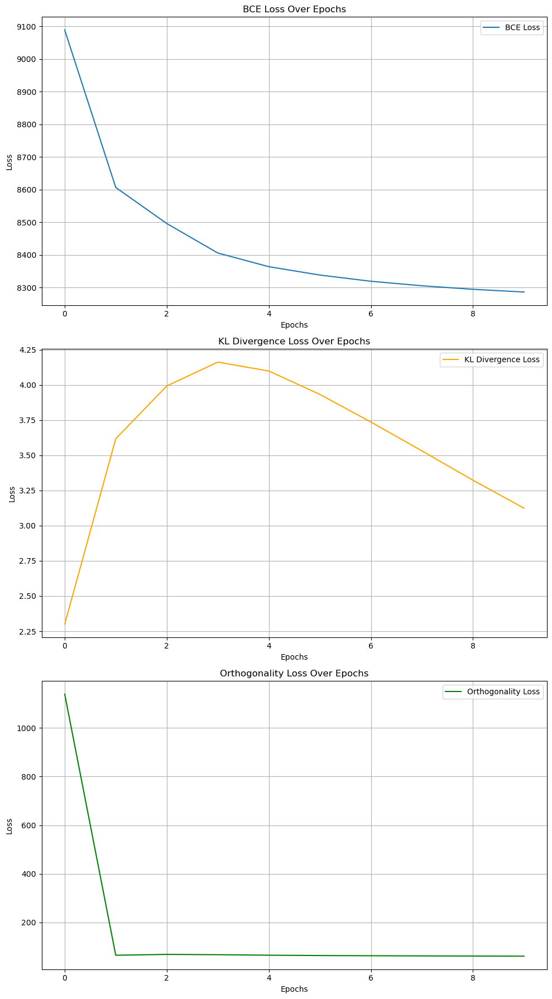

In [7]:
import matplotlib.pyplot as plt


bce_losses = []
kl_losses = []
ortho_losses = []

for epoch_losses in list_loss:
    epoch_bce = [loss[0] for loss in epoch_losses]
    epoch_kl = [loss[1] for loss in epoch_losses]
    epoch_ortho = [loss[2] for loss in epoch_losses]

    bce_losses.append(sum(epoch_bce) / len(epoch_bce))  # Averaging the losses per epoch
    kl_losses.append(sum(epoch_kl) / len(epoch_kl))
    ortho_losses.append(sum(epoch_ortho) / len(epoch_ortho))


fig, axs = plt.subplots(3, 1, figsize=(10, 18))

# Plot BCE Loss
axs[0].plot(bce_losses, label='BCE Loss')
axs[0].set_xlabel('Epochs')
axs[0].set_ylabel('Loss')
axs[0].set_title('BCE Loss Over Epochs')
axs[0].legend()
axs[0].grid(True)

# Plot KL Divergence Loss
axs[1].plot(kl_losses, label='KL Divergence Loss', color='orange')
axs[1].set_xlabel('Epochs')
axs[1].set_ylabel('Loss')
axs[1].set_title('KL Divergence Loss Over Epochs')
axs[1].legend()
axs[1].grid(True)

# Plot Orthogonality Loss
axs[2].plot(ortho_losses, label='Orthogonality Loss', color='green')
axs[2].set_xlabel('Epochs')
axs[2].set_ylabel('Loss')
axs[2].set_title('Orthogonality Loss Over Epochs')
axs[2].legend()
axs[2].grid(True)

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


On voit que la contrainte d'orthogonalité diminue fortement et reste inchangée par la suite. La KL divergence augmente au début de l'entrainement. Pour avoir une reconstruction assez fidèle, on a du choisir un beta assez faible pour éviter de trop réguler. Cette augmentation est un problème que nousa vons également trovué dans la littérature, des solutions proposent d'introduire cette Loss à seulement quelques étapes du training, ou de réduire graduellement le facteur beta pour moins la prendre en compte. De plus, nous avons fait une approximation pour la divergence de Kullback-Leibler pour la somme de deux gaussiennes. Cet article J. R. Hershey and P. A. Olsen, "Approximating the Kullback Leibler Divergence Between Gaussian Mixture Models," propose une approximation que nous n'avons pas eu le temps de mettre en place.

In [4]:
checkpoint = torch.load('best_bivae_model_latdim_50_beta00001_alpha10.pth')

vae = VAE(input_dim, hidden_dim, latent_dim) 
vae.to(device)
vae.load_state_dict(checkpoint)

# Set the model to evaluation mode (if needed)
vae.eval()

VAE(
  (encoder): Encoder(
    (encoder): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Linear(in_features=256, out_features=128, bias=True)
      (3): LeakyReLU(negative_slope=0.01)
      (4): Linear(in_features=128, out_features=64, bias=True)
      (5): LeakyReLU(negative_slope=0.01)
      (6): Linear(in_features=64, out_features=200, bias=True)
    )
  )
  (decoder): Decoder(
    (decoder): Sequential(
      (0): Linear(in_features=50, out_features=64, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Linear(in_features=64, out_features=128, bias=True)
      (3): LeakyReLU(negative_slope=0.01)
      (4): Linear(in_features=128, out_features=256, bias=True)
      (5): LeakyReLU(negative_slope=0.01)
      (6): Linear(in_features=256, out_features=512, bias=True)
      (7): Sigmoid()
    )
  )
)

In [13]:
z_sample = np.random.RandomState(2).randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

# Generate the original image
img_original = G.synthesis(w_sample, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()


# Convert w_sample to numpy and select the second element in the latent vector (w space)
w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :] 

In [14]:
def encode_decode_sample(vae, sample, preprocessing_pipeline):
    vae.eval()
    
    # Preprocess the sample
    sample_tr = preprocessing_pipeline.transform(sample)
    
    # Move the preprocessed sample to the device (GPU)
    sample_tr = torch.tensor(sample_tr, dtype=torch.float32).to(device)
    
    # Perform inference with the VAE
    with torch.no_grad():
        x_recon, mean1, log_var1, mean2, log_var2, z = vae(sample_tr)
    
    # Move x_recon to CPU and convert to numpy array
    x_recon_cpu = x_recon.cpu().numpy()
    
    # Inverse transform to get back the original data scale
    reconstructed_sample = preprocessing_pipeline.inverse_transform(x_recon_cpu)
    
    return reconstructed_sample

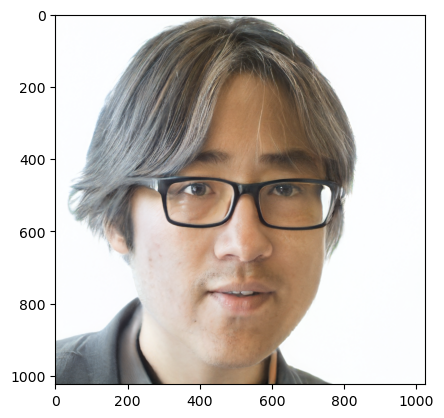

In [15]:
W_or= np.tile((w_sample), (1, 18, 1))
W_or_tensor = torch.tensor(W_or, dtype=torch.float32).to(device)
img_original = G.synthesis(W_or_tensor, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

plt.imshow(img_original)

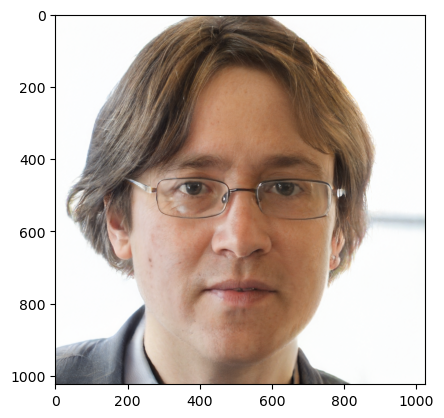

In [16]:
reconstructed_sample = encode_decode_sample(vae, w_sample, preprocessing_pipeline)

W_or= np.tile((reconstructed_sample), (1, 18, 1))
W_or_tensor = torch.tensor(W_or, dtype=torch.float32).to(device)
img_original = G.synthesis(W_or_tensor, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

plt.imshow(img_original)

In [17]:
def encode_sample(vae, sample, preprocessing_pipeline):
    vae.eval()
    
    # Preprocess the sample
    sample_tr = preprocessing_pipeline.transform(sample)
    
    # Move the preprocessed sample to the device (GPU)
    sample_tr = torch.tensor(sample_tr, dtype=torch.float32).to(device)
    
    # Perform inference with the VAE
    with torch.no_grad():
        x_recon, mean1, log_var1, mean2, log_var2, z = vae(sample_tr)
    
    # Move x_recon to CPU and convert to numpy array
    z = z.cpu().numpy()
    
    
    return mean1, log_var1, mean2, log_var2, z

# Expoloration of the latent space of this autoencoder

In [23]:
w_samples_test = generate_samples(G, 10000)

w_samples__test_scaled = preprocessing_pipeline.transform(w_samples_test)

w_samples_reconstructed = encode_decode_sample(vae,w_samples_test,preprocessing_pipeline)

In [30]:
mean1_samples, log_var1_samples, mean2_samples, log_var2_samples, z_samples = encode_sample(vae,w_samples_test,preprocessing_pipeline)

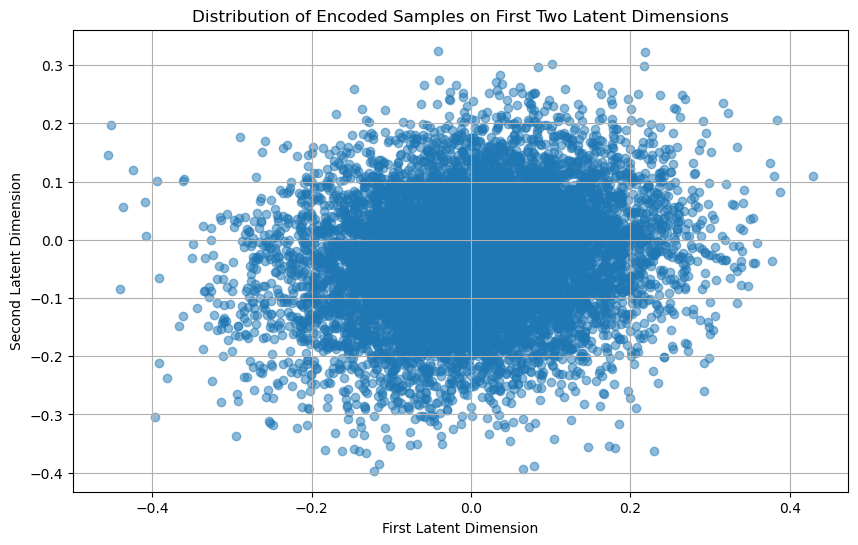

In [33]:
z_2d = z_samples[:, 2:4]

# Plot the samples on the first two axes of the latent space
plt.figure(figsize=(10, 6))
plt.scatter(z_2d[:, 0], z_2d[:, 1], alpha=0.5)
plt.xlabel('First Latent Dimension')
plt.ylabel('Second Latent Dimension')
plt.title('Distribution of Encoded Samples on First Two Latent Dimensions')
plt.grid(True)
plt.show()

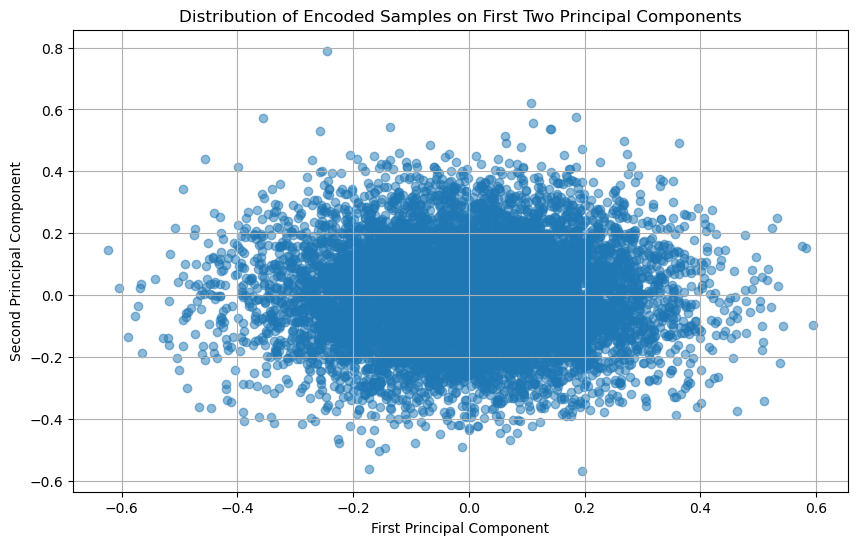

In [34]:
pca = PCA(n_components=2)
z_pca = pca.fit_transform(z_samples)

# Plot the samples in the 2D space defined by the first two principal components
plt.figure(figsize=(10, 6))
plt.scatter(z_pca[:, 0], z_pca[:, 1], alpha=0.5)
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.title('Distribution of Encoded Samples on First Two Principal Components')
plt.grid(True)
plt.show()

On a l'impression que la répartiton des points est une gaussienne sur chaque composante ici, on ne voit pas une claire distinction comme on l'aurait souhaité pour distinguer des features dans l'espace latent de cet autoencoder.

In [22]:
def get_pca(samples,ncomp):
    
    scaler = StandardScaler()
    samples_scaled = scaler.fit_transform(samples)  

    pca = PCA(n_components=ncomp)
    pca.fit(samples_scaled)

    explained_variance = pca.explained_variance_ratio_
    cumulative_explained_variance = np.cumsum(explained_variance)

    # Plot explained variance
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
    plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid',
         label='Cumulative Explained Variance')

    plt.xlabel('Principal Component Index')
    plt.ylabel('Explained Variance Ratio')
    plt.title('PCA Explained Variance')
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

    return pca , scaler

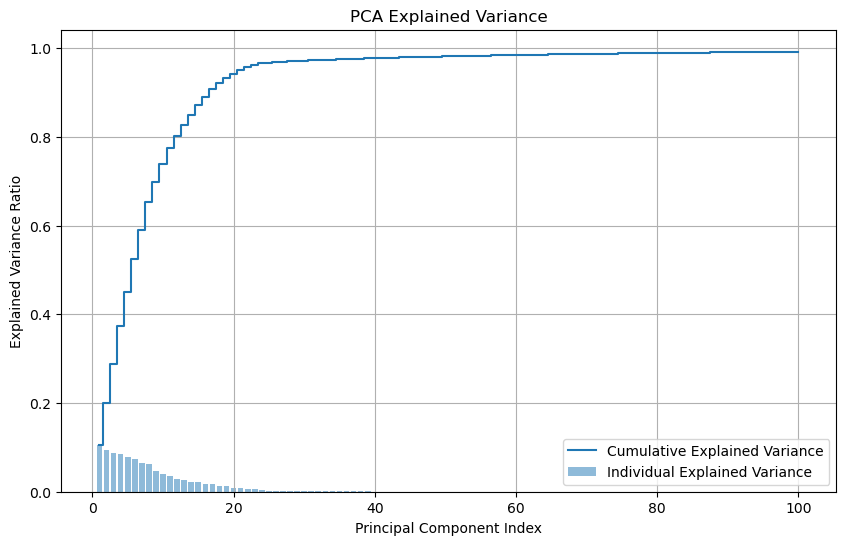

In [24]:
pca , scaler = get_pca(w_samples_reconstructed,ncomp=100)

What is interesting here is that compared to before, only 20 components explore more than 95% of all variance in this reconstructed space.

In [18]:
def move_according_to_component(G, device, pca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    explained_variance = pca.explained_variance_
    V = pca.components_.T
   
    # Generate a random z vector
    #z_sample = np.random.RandomState().randn(1, 512).astype(np.float32)  # select a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    w_sample = scaler.transform(w_sample)

    img_list = []
    w_list = []

    # Initialize x
    x = np.zeros((V.shape[1], 1))
    X =  np.tile(x, (1, num_steps))

    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(explained_variance[v])
        start_value = -2* sigma
        end_value = 2* sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
    
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
      
        w_new = w_sample.T + movement
        w_new = w_new.T
        w_new = scaler.inverse_transform(w_new)
        W = np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
        W[:,layers,:] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

In [19]:
def plot_results(img_list, X_list, num_images_plot=5):
   
    # Determine the indices of images to plot
    indices = np.linspace(0, len(img_list) - 1, num=num_images_plot, dtype=int)
    
    # Plot the images
    n_cols = 5
    n_rows = (num_images_plot + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()

    for i, idx in enumerate(indices):
        axes[i].imshow(img_list[idx])
        axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

Editing video ...
Saving optimization progress video "output_directory_autoencoder/gender_all.mp4"
Video saved


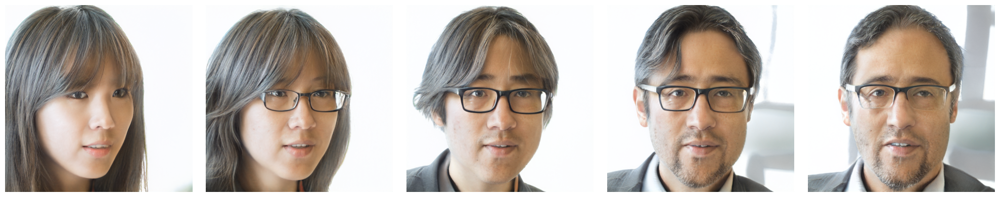

In [16]:
directions = [0]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_all',random_seed=2)

plot_results(img_list_gender, X_list_gender)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/gender_all.mp4"
Video saved


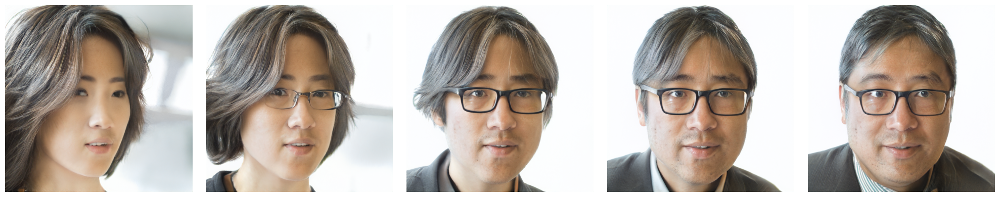

In [17]:
directions = [1]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_all',random_seed=2)

plot_results(img_list_gender, X_list_gender)

Editing video ...
Saving optimization progress video "output_directory_auotoencoder/gender_lw.mp4"
Video saved


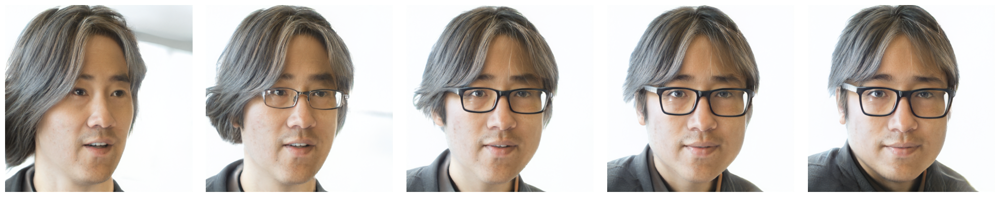

In [18]:
# Gender

directions = [1]
layers = [0,1,2]
img_list_gender_lw, X_list_gender_lw = move_according_to_component(G, device,pca, 'output_directory_auotoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_lw',random_seed=2)

plot_results(img_list_gender_lw, X_list_gender_lw)

Editing video ...
Saving optimization progress video "output_directory_auotoencoder/hair_color_lw.mp4"
Video saved


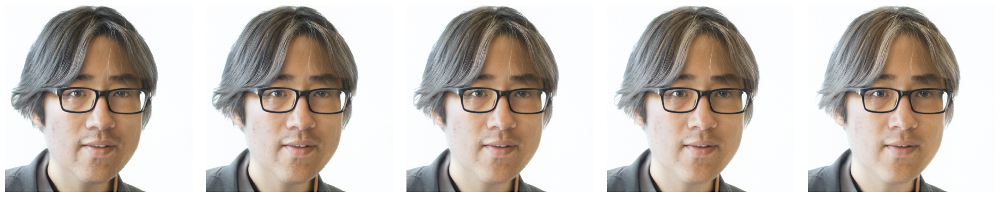

In [19]:
# Hair color

directions = [10]
layers = [7,8]
img_list_hair_color_lw, X_list_hair_color_lw = move_according_to_component(G, device,pca, 'output_directory_auotoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_color_lw',random_seed=2)

plot_results(img_list_hair_color_lw, X_list_hair_color_lw)

## Autoencoding the image

---

Here we auto encode the sample w from the original latent space to the space recreated by the auto encoder. Then we apply the modification as performed in the article GANSpace, using the principal component analysis on this new restructured space.

In [27]:
def move_according_to_component_autoencoder(G, device, pca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):

    
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    explained_variance = pca.explained_variance_
    V = pca.components_.T
   
    # Generate a random z vector
    #z_sample = np.random.RandomState().randn(1, 512).astype(np.float32)  # select a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    reconstructed_sample = encode_decode_sample(vae, w_sample, preprocessing_pipeline)
    reconstructed_sample = scaler.transform(reconstructed_sample)

    img_list = []
    w_list = []

    # Initialize x
    x = np.zeros((V.shape[1], 1))
    X =  np.tile(x, (1, num_steps))

    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(explained_variance[v])
        start_value = -2* sigma
        end_value = 2* sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
    
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
      
        w_new = reconstructed_sample.T + movement
        # here the difference is that we use reconstructed sample  instead of the original sample
        w_new = w_new.T
        w_new = scaler.inverse_transform(w_new)
        W = np.tile(scaler.inverse_transform(reconstructed_sample), (1, 18, 1))
        
        W[:,layers,:] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

Editing video ...
Saving optimization progress video "output_directory_autoencoder/gender_all_projected.mp4"
Video saved


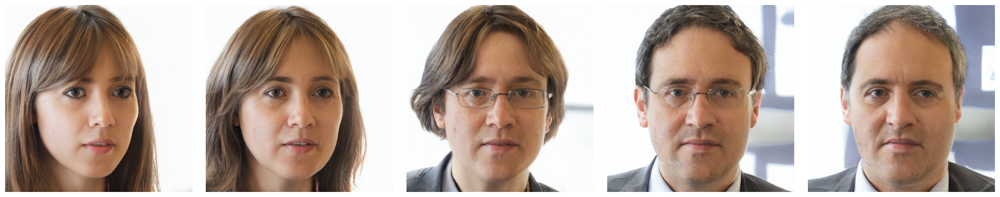

In [32]:
directions = [0]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_all_projected',random_seed=2)

plot_results(img_list_gender, X_list_gender)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/direcion1_projected.mp4"
Video saved


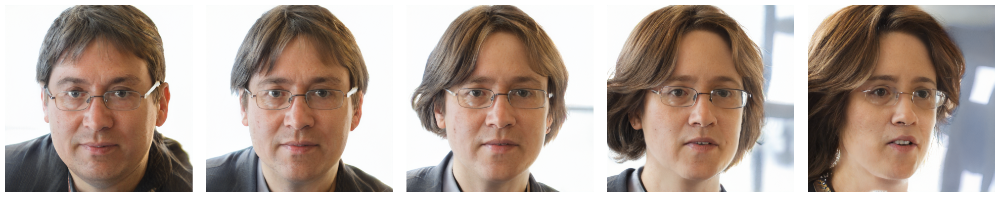

In [33]:
directions = [1]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='direcion1_projected',random_seed=2)

plot_results(img_list_gender, X_list_gender)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/direcion2_projected.mp4"
Video saved


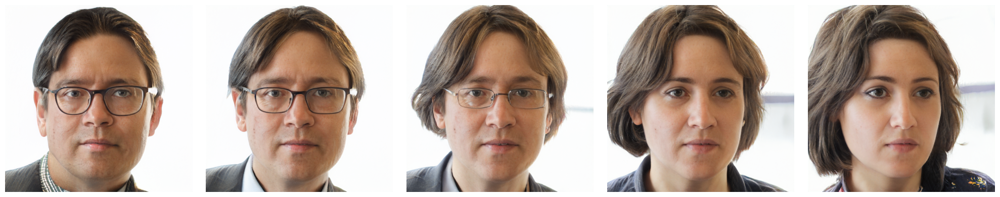

In [28]:
directions = [2]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='direcion2_projected',random_seed=2)

plot_results(img_list_gender, X_list_gender)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/hair_color_lw_projected.mp4"
Video saved


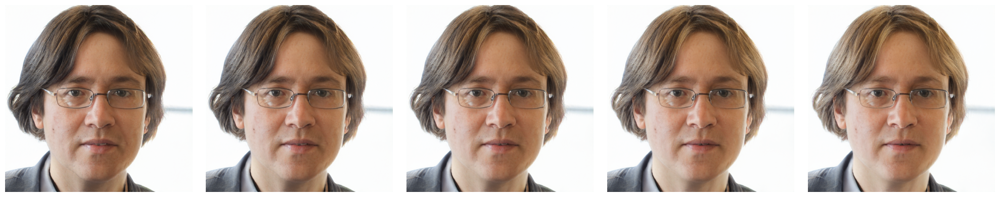

In [29]:
# Hair color

directions = [10]
layers = [7,8]
img_list_hair_color_lw, X_list_hair_color_lw = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_color_lw_projected',random_seed=2)

plot_results(img_list_hair_color_lw, X_list_hair_color_lw)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/age_hairstyle_lw_projected.mp4"
Video saved


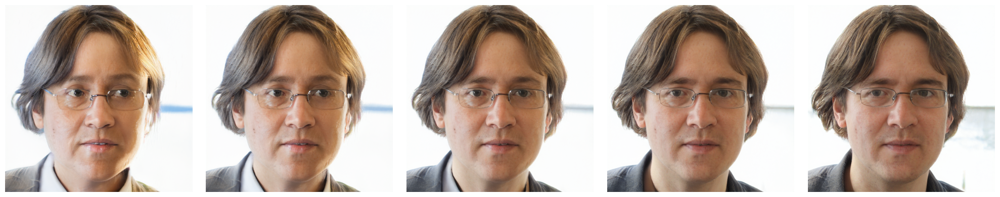

In [30]:
# Age and hairstyle

directions = [4]
layers = list(range(5, 18))
img_list_age_lw,X_list_age_lw = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='age_hairstyle_lw_projected',random_seed=2)


plot_results(img_list_age_lw, X_list_age_lw)

Editing video ...
Saving optimization progress video "output_directory_autoencoder/gender_lw_projected.mp4"
Video saved


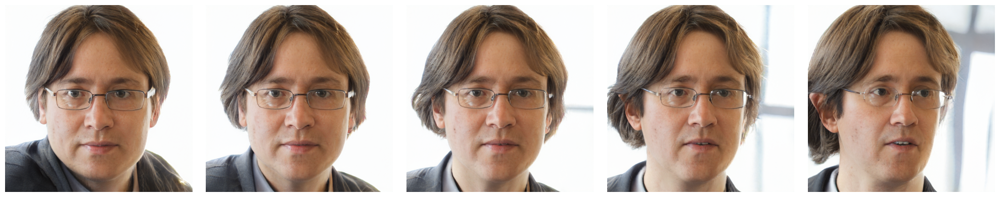

In [31]:
# Gender

directions = [1]
layers = [0,1,2]
img_list_gender_lw, X_list_gender_lw = move_according_to_component_autoencoder(G, device,pca, 'output_directory_autoencoder', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_lw_projected',random_seed=2)

plot_results(img_list_gender_lw, X_list_gender_lw)

We get similar results about the different types of modifications brought in different directions/layers. However there are still entanglements between features.